In [12]:
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['font.sans-serif'] = ['Times New Roman']
plt.rcParams['figure.dpi'] = 500
plt.rcParams['text.color'] = 'w'
plt.rcParams['axes.labelcolor'] = 'k'
plt.rcParams['xtick.color'] = 'w'
plt.rcParams['ytick.color'] = 'w'
plt.rcParams['axes.edgecolor'] = 'w'
plt.rcParams['figure.facecolor'] = 'k'
plt.rcParams['axes.facecolor'] = 'k'
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib.colors import LogNorm
from matplotlib.patches import FancyArrowPatch
import matplotlib.colors as colors
from astropy.visualization import SqrtStretch, LinearStretch, LogStretch
from astropy.visualization.mpl_normalize import ImageNormalize
import pandas as pd
import re
from astropy.io import fits
import os
from scipy.ndimage import map_coordinates
from scipy.stats import binned_statistic
from scipy.spatial.distance import cdist
from scipy.optimize import linear_sum_assignment
from pathlib import Path

from matplotlib.lines import Line2D
os.chdir("/Users/ainsleylewis/Documents/Astronomy/IllustrisTNG Lens Modelling")

In [20]:

m = [1, 2, 3, 4, 5]
n = [1, 2, 3, 4, 5]
base_path = Path("MPOLE")

# Create a 2D list (a list of lists)
fits_data_grid = []

for i, m_val in enumerate(m):
    # Create a new row for each value in m
    row = []
    for j, n_val in enumerate(n):
        file_path = base_path / f"mpole_{m_val}_{n_val}_lens.fits"
        try:
            row.append(fits.open(file_path))
        except FileNotFoundError:
            row.append(None)
    
    # Add the completed row to the main grid
    fits_data_grid.append(row)

# --- How to use this structure ---

# Access by index: get the data for the 3rd m-value and 4th n-value
# m[2] is 3, n[3] is 4. Indices are 0-based.
hdul_by_index = fits_data_grid[2][3] 

if hdul_by_index:
    print("\nInfo for m=3, n=4 (accessed by index [2][3]):")
    hdul_by_index.info()

# Clean up
# for row in fits_data_grid:
#     for hdul in row:
#         if hdul:
#             hdul.close()


Info for m=3, n=4 (accessed by index [2][3]):
Filename: MPOLE/mpole_3_4_lens.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      27   (1560, 1560, 8)   float32   


In [ ]:
lens_1_1 = fits_data_grid[0][0]
lens_1_1_kap = lens_1_1[0].data[3]
lens_1_1_kap

lens_1_2 = fits_data_grid[0][1]
lens_1_2_kap = lens_1_2[0].data[3]
lens_1_2_kap

lens_1_3 = fits_data_grid[0][2]
lens_1_3_kap = lens_1_3[0].data[3]
lens_1_3_kap

lens_1_4 = fits_data_grid[0][3]
lens_1_4_kap = lens_1_4[0].data[3]
lens_1_4_kap

lens_1_5 = fits_data_grid[0][4]
lens_1_5_kap = lens_1_5[0].data[3]
lens_1_5_kap

array([[ 1.1637322e-13,  1.1659735e-13,  1.1682192e-13, ...,
         1.1682203e-13,  1.1659741e-13,  1.1637315e-13],
       [ 1.1644781e-13,  1.1667236e-13,  1.1689735e-13, ...,
         1.1689742e-13,  1.1667250e-13,  1.1644787e-13],
       [ 1.1652228e-13,  1.1674715e-13,  1.1697255e-13, ...,
         1.1697253e-13,  1.1674715e-13,  1.1652205e-13],
       ...,
       [-1.1652228e-13, -1.1674723e-13, -1.1697259e-13, ...,
        -1.1697253e-13, -1.1674711e-13, -1.1652205e-13],
       [-1.1644795e-13, -1.1667243e-13, -1.1689732e-13, ...,
        -1.1689728e-13, -1.1667227e-13, -1.1644766e-13],
       [-1.1637311e-13, -1.1659751e-13, -1.1682178e-13, ...,
        -1.1682175e-13, -1.1659728e-13, -1.1637310e-13]], dtype='>f4')

/var/folders/tm/964hg0yn70x0ddsqcj4bsf8r0000gn/T/ipykernel_4161/2999243663.py:3: UserWarning: The following kwargs were not used by contour: 'cbar'
  plt.contour(lens_1_1_kap, levels=10, alpha=1, colors ='w', linewidths=0.5, linestyles='solid', cbar=False)


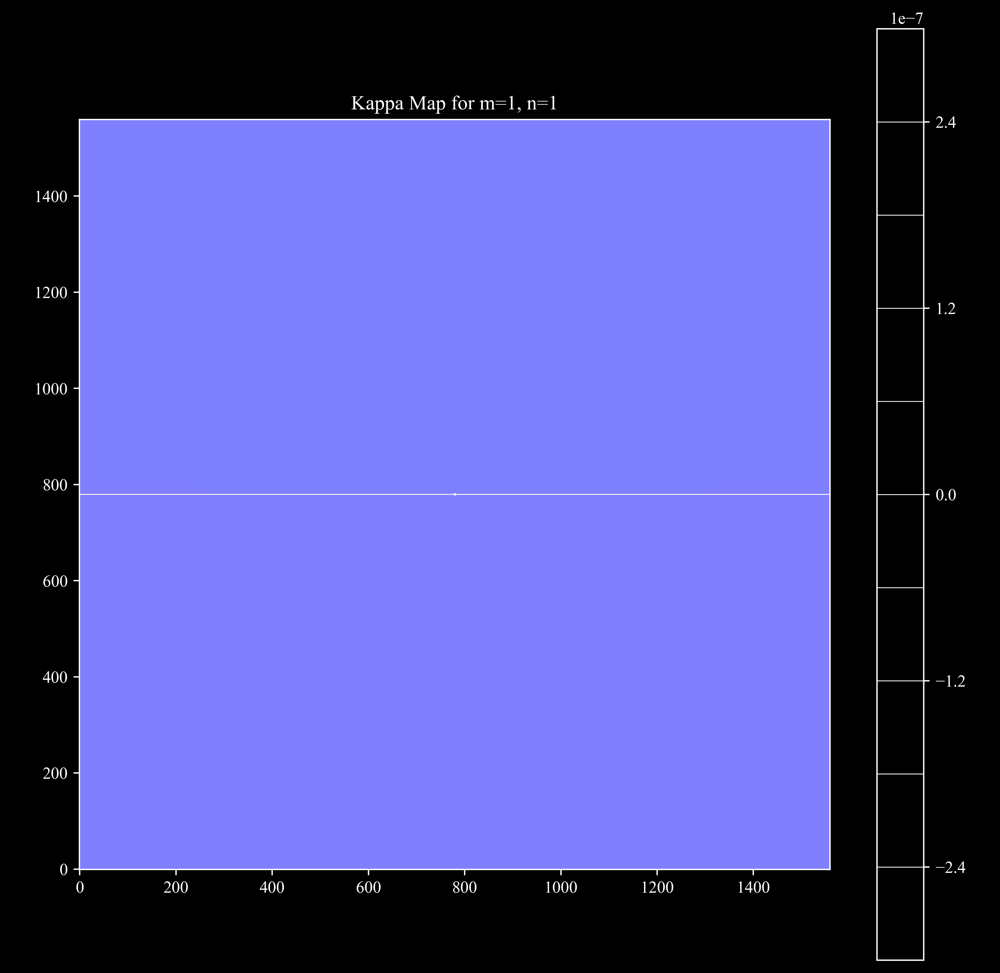

In [ ]:
plt.figure(figsize=(10, 10))
plt.imshow(lens_1_1_kap, origin='lower', cmap='cool')
plt.contour(lens_1_1_kap, levels=10, alpha=1, colors ='w', linewidths=0.5, linestyles='solid')
plt.colorbar(label='Kappa', orientation='vertical')
plt.title('Kappa Map for m=1, n=1')
plt.xlabel('X Pixel')
plt.ylabel('Y Pixel')
plt.grid(False)
plt.show()

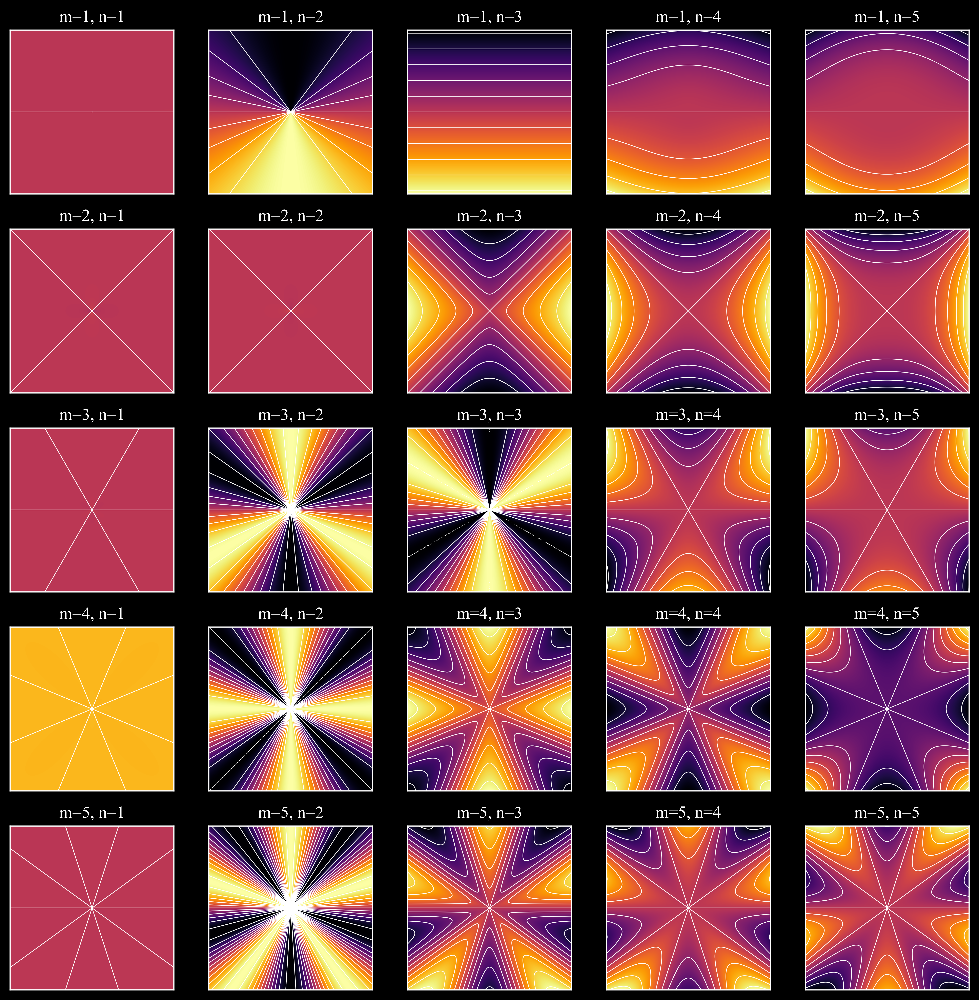

In [64]:
fig, ax = plt.subplots(5,5, figsize=(10, 10), sharex=True, sharey=True)

for i in range(len(m)):
    for j in range(len(n)):
        if fits_data_grid[i][j]:
            kap = fits_data_grid[i][j][0].data[3]
            ax[i, j].imshow(kap, origin='lower', cmap='inferno')
            ax[i, j].contour(kap, levels=10, alpha=1, colors ='w', linewidths=0.5, linestyles='solid')
            ax[i, j].set_title(f'm={m[i]}, n={n[j]}')
            ax[i, j].set_xticks([])
            ax[i, j].set_yticks([])
            ax[i, j].grid(False)
plt.tight_layout()
plt.show()


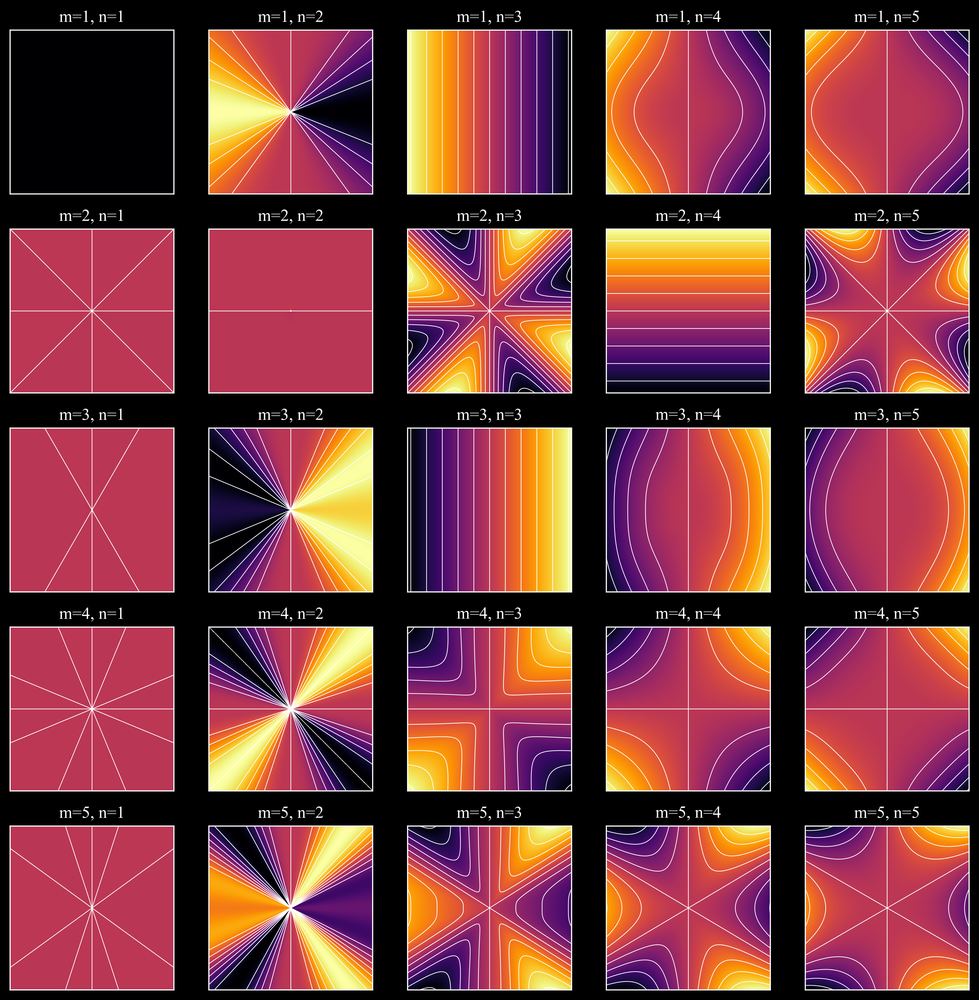

In [66]:
fig, ax = plt.subplots(5,5, figsize=(10, 10), sharex=True, sharey=True)

for i in range(len(m)):
    for j in range(len(n)):
        if fits_data_grid[i][j]:
            kap = fits_data_grid[i][j][0].data[5]
            ax[i, j].imshow(kap, origin='lower', cmap='inferno')
            ax[i, j].contour(kap, levels=10, alpha=1, colors ='w', linewidths=0.5, linestyles='solid')
            ax[i, j].set_title(f'm={m[i]}, n={n[j]}')
            ax[i, j].set_xticks([])
            ax[i, j].set_yticks([])
            ax[i, j].grid(False)
plt.tight_layout()
plt.show()
